In [1]:
import pandas as pd
import numpy as np
import math
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as ss
from scipy.stats import probplot
from scipy import stats
import warnings
warnings.filterwarnings('ignore')
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import StandardScaler
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler
import os
import sys

%matplotlib inline

pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows', None)

In [2]:
from sqlalchemy import create_engine
import getpass  # To get the password without showing the input
password = getpass.getpass()
connection_string = 'mysql+pymysql://root:' + password + '@localhost/house_price_regression'
engine = create_engine(connection_string)
data = pd.read_sql_query('SELECT * FROM house_price_data', engine)
data.head()

········


,id,date,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zip_code,lat,lon,sqft_living15,sqft_lot15,price
0,7129300520,10/13/14,3,1.00,1180.0,5650.0,1.0,0,0,3,7,1180.0,0.0,1955,0,98178,47.5112,-122.257,1340.0,5650.0,221900
1,6414100192,12/9/14,3,2.25,2570.0,7242.0,2.0,0,0,3,7,2170.0,400.0,1951,1991,98125,47.7210,-122.319,1690.0,7639.0,538000
2,5631500400,2/25/15,2,1.00,770.0,10000.0,1.0,0,0,3,6,770.0,0.0,1933,0,98028,47.7379,-122.233,2720.0,8062.0,180000
3,2487200875,12/9/14,4,3.00,1960.0,5000.0,1.0,0,0,5,7,1050.0,910.0,1965,0,98136,47.5208,-122.393,1360.0,5000.0,604000
4,1954400510,2/18/15,3,2.00,1680.0,8080.0,1.0,0,0,3,8,1680.0,0.0,1987,0,98074,47.6168,-122.045,1800.0,7503.0,510000


In [3]:
data['sqft_lot15'].unique()

array([5650., 7639., 8062., ..., 5731., 1509., 2007.])

In [4]:
data.describe()

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zip_code,lat,lon,sqft_living15,sqft_lot15,price
count,21597.000000,21597.000000,21597.000000,2.159700e+04,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,2.159700e+04
mean,3.373200,2.115826,2080.321850,1.509941e+04,1.494096,0.007547,0.234292,3.409825,7.657915,1788.596842,291.725008,1970.999676,84.464787,98077.951845,47.560093,-122.213982,1986.620318,12758.283512,5.402966e+05
std,0.926299,0.768984,918.106125,4.141264e+04,0.539683,0.086549,0.766390,0.650546,1.173200,827.759761,442.667800,29.375234,401.821438,53.513072,0.138552,0.140724,685.230472,27274.441950,3.673681e+05
min,1.000000,0.500000,370.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,3.000000,370.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000,7.800000e+04
25%,3.000000,1.750000,1430.000000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,98033.000000,47.471100,-122.328000,1490.000000,5100.000000,3.220000e+05
50%,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.231000,1840.000000,7620.000000,4.500000e+05
75%,4.000000,2.500000,2550.000000,1.068500e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000,6.450000e+05
max,33.000000,8.000000,13540.000000,1.651360e+06,3.500000,1.000000,4.000000,5.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000,7.700000e+06


In [5]:
data.dtypes

id                object
date              object
bedrooms           int64
bathrooms        float64
sqft_living      float64
sqft_lot         float64
floors           float64
waterfront         int64
view               int64
condition          int64
grade              int64
sqft_above       float64
sqft_basement    float64
yr_built           int64
yr_renovated       int64
zip_code           int64
lat              float64
lon              float64
sqft_living15    float64
sqft_lot15       float64
price              int64
dtype: object

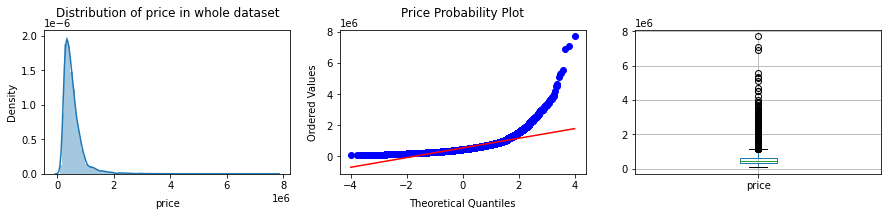

In [6]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize = (15,2))
plt.subplots_adjust(left=None, bottom=5, right=None, top=6, wspace=None, hspace=None)

sns.distplot(data['price'], hist=True, bins = 100, ax=ax1)
probplot(data['price'], plot=ax2)
data.boxplot('price', ax=ax3)

ax1.set_xlabel('price', size=10, labelpad=8)
ax2.set_xlabel('Theoretical Quantiles', size=10, labelpad=8)
ax2.set_ylabel('Ordered Values', size=10, labelpad=8)

ax1.set_title('Distribution of price in whole dataset', size=12, y=1.05)
ax2.set_title('Price Probability Plot', size=12, y=1.05)

plt.show()

In [7]:
data['date']= pd.to_datetime(data['date'],errors='coerce')
data['zip_code']= data['zip_code'].astype(str)

In [9]:
# data['month']= data['date'][0].month

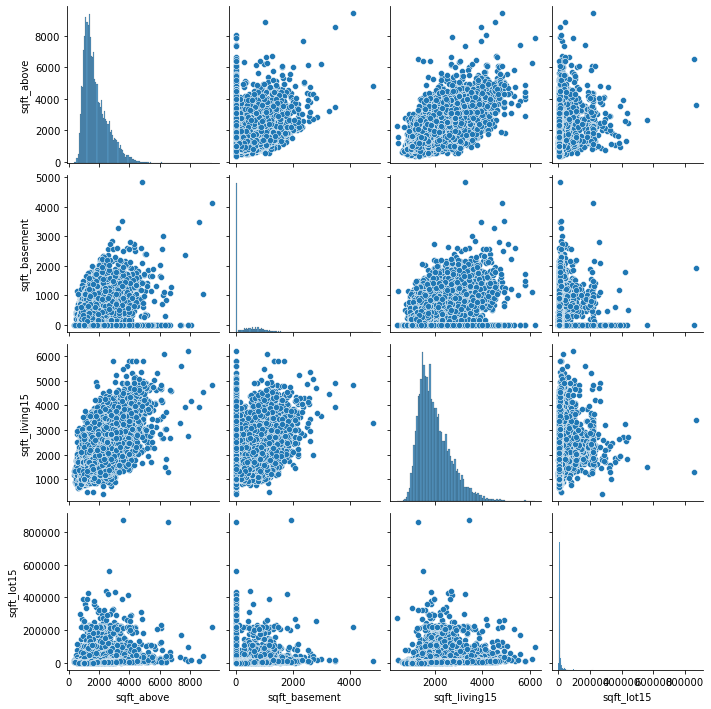

In [10]:
sns.pairplot(data[['sqft_above','sqft_basement','sqft_living15','sqft_lot15']])

In [11]:
data= data.drop(['lat','lon','sqft_living', 'sqft_lot','date','sqft_above','id'], axis = 1)

In [12]:
# data['effective_to_date'] = pd.to_datetime(data['effective_to_date'], errors='coerce')
# data['effective_to_date'][0].day
# data['effective_to_date'][0].month
# data['effective_to_date'][0].year
# data['effective_to_date'][0].isoweekday()  # Returns 1 for Monday and so on
# data['effective_to_date'][0].time()
# data['effective_to_date'][0].strftime(format='%d-%M-%Y')
# data['effective_to_date'][0].strftime(format="%A %d. %B %Y")

In [13]:
data.head(2)

,bedrooms,bathrooms,floors,waterfront,view,condition,grade,sqft_basement,yr_built,yr_renovated,zip_code,sqft_living15,sqft_lot15,price
0,3,1.00,1.0,0,0,3,7,0.0,1955,0,98178,1340.0,5650.0,221900
1,3,2.25,2.0,0,0,3,7,400.0,1951,1991,98125,1690.0,7639.0,538000


In [14]:
data['yr_renovated'].unique()

array([   0, 1991, 2002, 2010, 1999, 1992, 2013, 1994, 1978, 2005, 2008,
       2003, 1984, 1954, 2014, 2011, 1974, 1983, 1945, 1990, 1988, 1957,
       1977, 1981, 1995, 2000, 1998, 1970, 1989, 2004, 1986, 2009, 2007,
       1987, 1973, 2006, 1985, 2001, 1980, 1971, 1979, 1997, 1950, 1969,
       1948, 2015, 1968, 2012, 1963, 1951, 1993, 1962, 1996, 1972, 1953,
       1955, 1982, 1956, 1940, 1976, 1946, 1975, 1958, 1964, 1959, 1960,
       1967, 1965, 1934, 1944], dtype=int64)

In [15]:
data['waterfront'] = data['waterfront'].apply(lambda x: 1 if x > 0 else 0)
data['sqft_basement'] = data['sqft_basement'].apply(lambda x: 1 if x > 0 else 0)

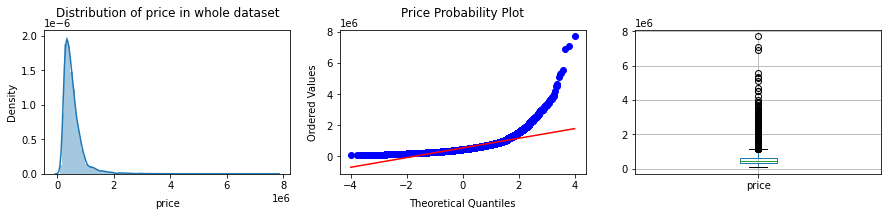

In [16]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize = (15,2))
plt.subplots_adjust(left=None, bottom=5, right=None, top=6, wspace=None, hspace=None)

sns.distplot(data['price'], hist=True, bins = 100, ax=ax1)
probplot(data['price'], plot=ax2)
data.boxplot('price', ax=ax3)

ax1.set_xlabel('price', size=10, labelpad=8)
ax2.set_xlabel('Theoretical Quantiles', size=10, labelpad=8)
ax2.set_ylabel('Ordered Values', size=10, labelpad=8)

ax1.set_title('Distribution of price in whole dataset', size=12, y=1.05)
ax2.set_title('Price Probability Plot', size=12, y=1.05)

plt.show()

In [17]:
data.drop(index=data[(data['bedrooms'] > 6)].index)

,bedrooms,bathrooms,floors,waterfront,view,condition,grade,sqft_basement,yr_built,yr_renovated,zip_code,sqft_living15,sqft_lot15,price
0,3,1.00,1.0,0,0,3,7,0,1955,0,98178,1340.0,5650.0,221900
1,3,2.25,2.0,0,0,3,7,1,1951,1991,98125,1690.0,7639.0,538000
2,2,1.00,1.0,0,0,3,6,0,1933,0,98028,2720.0,8062.0,180000
3,4,3.00,1.0,0,0,5,7,1,1965,0,98136,1360.0,5000.0,604000
4,3,2.00,1.0,0,0,3,8,0,1987,0,98074,1800.0,7503.0,510000
5,4,4.50,1.0,0,0,3,11,1,2001,0,98053,4760.0,101930.0,1230000
6,3,2.25,2.0,0,0,3,7,0,1995,0,98003,2238.0,6819.0,257500
7,3,1.50,1.0,0,0,3,7,0,1963,0,98198,1650.0,9711.0,291850
8,3,1.00,1.0,0,0,3,7,1,1960,0,98146,1780.0,8113.0,229500
9,3,2.50,2.0,0,0,3,7,0,2003,0,98038,2390.0,7570.0,323000


In [18]:
data.drop(index=data[(data['bathrooms'] > 6)].index)

,bedrooms,bathrooms,floors,waterfront,view,condition,grade,sqft_basement,yr_built,yr_renovated,zip_code,sqft_living15,sqft_lot15,price
0,3,1.00,1.0,0,0,3,7,0,1955,0,98178,1340.0,5650.0,221900
1,3,2.25,2.0,0,0,3,7,1,1951,1991,98125,1690.0,7639.0,538000
2,2,1.00,1.0,0,0,3,6,0,1933,0,98028,2720.0,8062.0,180000
3,4,3.00,1.0,0,0,5,7,1,1965,0,98136,1360.0,5000.0,604000
4,3,2.00,1.0,0,0,3,8,0,1987,0,98074,1800.0,7503.0,510000
5,4,4.50,1.0,0,0,3,11,1,2001,0,98053,4760.0,101930.0,1230000
6,3,2.25,2.0,0,0,3,7,0,1995,0,98003,2238.0,6819.0,257500
7,3,1.50,1.0,0,0,3,7,0,1963,0,98198,1650.0,9711.0,291850
8,3,1.00,1.0,0,0,3,7,1,1960,0,98146,1780.0,8113.0,229500
9,3,2.50,2.0,0,0,3,7,0,2003,0,98038,2390.0,7570.0,323000


In [52]:
data.drop(index=data[(data['price'] > 6000000)].index)

,bedrooms,bathrooms,floors,waterfront,view,condition,grade,sqft_basement,yr_built,yr_renovated,zip_code,sqft_living15,sqft_lot15,price,price_log,price_boxcox
0,3,1.00,1.0,0,0,3,7,0,1955,0,98178,1340.0,5650.0,221900,12.309982,91.678420
1,3,2.25,2.0,0,0,3,7,1,1951,1991,98125,1690.0,7639.0,538000,13.195614,116.552340
2,2,1.00,1.0,0,0,3,6,0,1933,0,98028,2720.0,8062.0,180000,12.100712,86.595141
3,4,3.00,1.0,0,0,5,7,1,1965,0,98136,1360.0,5000.0,604000,13.311329,120.248581
4,3,2.00,1.0,0,0,3,8,0,1987,0,98074,1800.0,7503.0,510000,13.142166,114.882463
6,3,2.25,2.0,0,0,3,7,0,1995,0,98003,2238.0,6819.0,257500,12.458775,95.465580
7,3,1.50,1.0,0,0,3,7,0,1963,0,98198,1650.0,9711.0,291850,12.583995,98.768889
8,3,1.00,1.0,0,0,3,7,1,1960,0,98146,1780.0,8113.0,229500,12.343658,92.522717
9,3,2.50,2.0,0,0,3,7,0,2003,0,98038,2390.0,7570.0,323000,12.685408,101.524518
10,3,2.50,1.0,0,0,3,8,1,1965,0,98007,2210.0,8925.0,662500,13.403776,123.282932


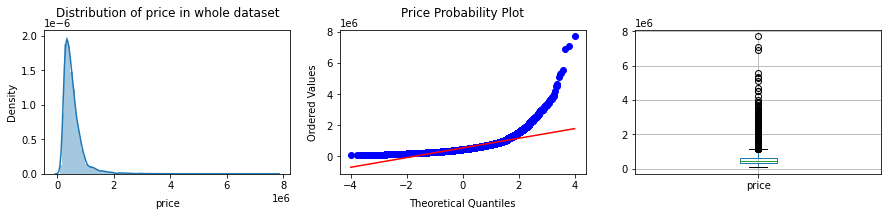

In [19]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize = (15,2))
plt.subplots_adjust(left=None, bottom=5, right=None, top=6, wspace=None, hspace=None)

sns.distplot(data['price'], hist=True, bins = 100, ax=ax1)
probplot(data['price'], plot=ax2)
data.boxplot('price', ax=ax3)

ax1.set_xlabel('price', size=10, labelpad=8)
ax2.set_xlabel('Theoretical Quantiles', size=10, labelpad=8)
ax2.set_ylabel('Ordered Values', size=10, labelpad=8)

ax1.set_title('Distribution of price in whole dataset', size=12, y=1.05)
ax2.set_title('Price Probability Plot', size=12, y=1.05)

plt.show()

In [20]:
# data.value_counts()

In [21]:
def display_missing(df):
    """shows the number of missing values of each column for a date_frame, if there is one"""
    for col in df.columns.tolist():
        if df[col].isnull().sum():
            print('{} column missing values: {}/{}'.format(col, df[col].isnull().sum(), len(df)))
    print ('Done checking for missing values')

In [22]:
display_missing(data)

Done checking for missing values


In [23]:
num=data.select_dtypes(include='number')
col=data.select_dtypes(include='object')

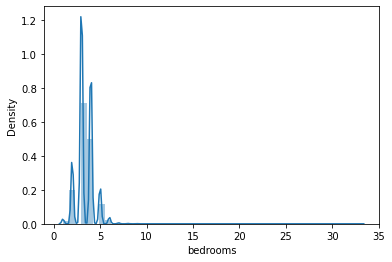

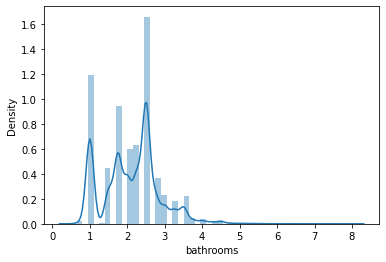

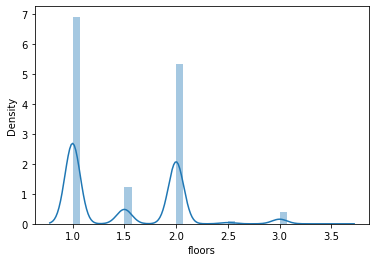

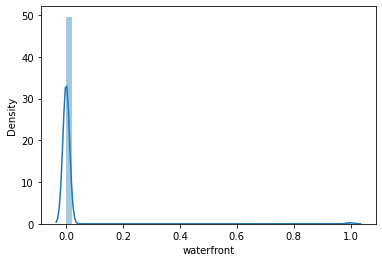

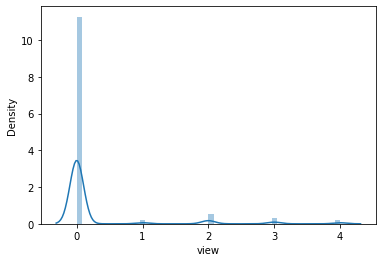

...

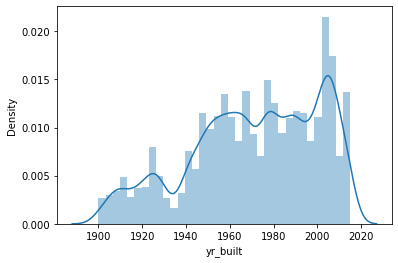

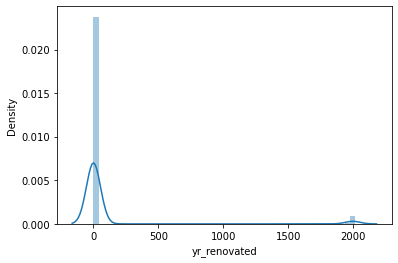

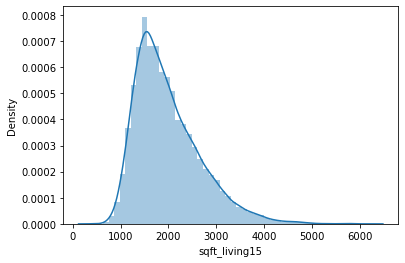

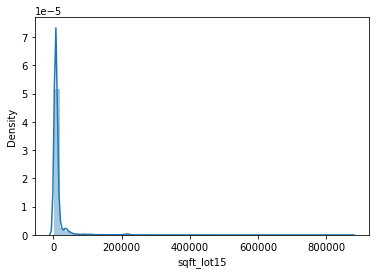

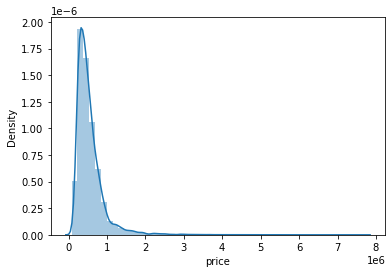

In [24]:
for i in num:
    sns.distplot(num[i])
    plt.show()

In [25]:
for col in data.columns:
    pct_missing = np.mean(data[col].isnull())
    print('{} - {}%'.format(col, round(pct_missing*100)))

bedrooms - 0%
bathrooms - 0%
floors - 0%
waterfront - 0%
view - 0%
condition - 0%
grade - 0%
sqft_basement - 0%
yr_built - 0%
yr_renovated - 0%
zip_code - 0%
sqft_living15 - 0%
sqft_lot15 - 0%
price - 0%


In [26]:
print('Categorical Features:', len(num))
print('----------')
for c in num:
    print('Name: {}'.format(num[c].name))    # column name
    print('Type: {}'.format(num[c].dtype))   # column type
    print('Unique values: {}'.format(len(num[c].unique())))   # column unique values
    print(num[c].unique())
    print(((num[c].value_counts()/ sum(num[c].value_counts()))*100))   # percentage
    print('\n----------')


Categorical Features: 21597
----------
Name: bedrooms
Type: int64
Unique values: 12
[ 3  2  4  5  1  6  7  8  9 11 10 33]
3     45.487799
4     31.865537
2     12.779553
5      7.413067
6      1.259434
1      0.907533
7      0.175950
8      0.060194
9      0.027782
10     0.013891
11     0.004630
33     0.004630
Name: bedrooms, dtype: float64

----------
Name: bathrooms
Type: float64
Unique values: 29
[1.   2.25 3.   2.   4.5  1.5  2.5  1.75 2.75 3.25 4.   3.5  0.75 4.75
 5.   4.25 3.75 1.25 5.25 6.   0.5  5.5  6.75 5.75 8.   7.5  7.75 6.25
 6.5 ]
2.50    24.896976
1.00    17.831180
1.75    14.113071
2.25     9.478168
2.00     8.936426
1.50     6.690744
2.75     5.486873
3.00     3.486595
3.50     3.384729
3.25     2.727231
3.75     0.717692
4.00     0.629717
4.50     0.463027
4.25     0.365792
0.75     0.328749
4.75     0.106496
5.00     0.097236
5.25     0.060194
5.50     0.046303
1.25     0.041672
6.00     0.027782
5.75     0.018521
0.50     0.018521
8.00     0.009261
6.25     0.009

Name: sqft_living15, dtype: float64

----------
Name: sqft_lot15
Type: float64
Unique values: 8682
[5650. 7639. 8062. ... 5731. 1509. 2007.]
5000.0      1.977126
4000.0      1.648377
6000.0      1.333519
7200.0      0.972357
4800.0      0.671390
7500.0      0.657499
8400.0      0.537112
4500.0      0.513960
3600.0      0.513960
5100.0      0.504700
4080.0      0.490809
8000.0      0.486179
9600.0      0.453767
8100.0      0.430615
9000.0      0.425985
7800.0      0.398203
7700.0      0.393573
5500.0      0.375052
5400.0      0.328749
6600.0      0.314859
7350.0      0.310228
5200.0      0.305598
5750.0      0.296337
4400.0      0.291707
4200.0      0.282447
10000.0     0.268556
7560.0      0.263926
3000.0      0.240774
5250.0      0.240774
9750.0      0.226883
7620.0      0.217623
7000.0      0.212993
8800.0      0.212993
10800.0     0.208362
6250.0      0.203732
7210.0      0.199102
8250.0      0.194471
10125.0     0.189841
3800.0      0.189841
6380.0      0.185211
12000.0     0.18058

Name: sqft_lot15, dtype: float64

----------
Name: price
Type: int64
Unique values: 3622
[221900 538000 180000 ... 541800 610685 402101]
450000     0.796407
350000     0.796407
550000     0.736213
500000     0.703801
425000     0.694541
325000     0.685280
400000     0.671390
375000     0.638978
300000     0.615826
525000     0.606566
250000     0.601935
475000     0.555633
330000     0.551002
650000     0.541742
275000     0.523221
415000     0.513960
315000     0.513960
600000     0.509330
390000     0.509330
280000     0.504700
440000     0.504700
320000     0.495439
435000     0.486179
340000     0.476918
310000     0.467658
335000     0.453767
420000     0.449136
360000     0.444506
260000     0.439876
265000     0.435246
575000     0.430615
625000     0.430615
305000     0.425985
380000     0.425985
430000     0.421355
345000     0.421355
530000     0.421355
270000     0.416725
465000     0.412094
245000     0.412094
700000     0.412094
370000     0.407464
290000     0.407464
490

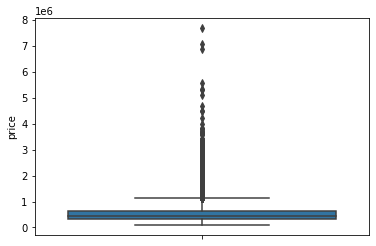

In [27]:
sns.boxplot(y = 'price', data=num)
plt.show()

In [28]:
iqr = np.percentile(data['price'],75) - np.percentile(data['price'],25)
upper_limit = np.percentile(data['price'],75) + iqr
lower_limit = np.percentile(data['price'],25) - iqr
data=data[(data['price']>lower_limit) & (data['price']<upper_limit)]

In [29]:
num=data.select_dtypes(include='number')

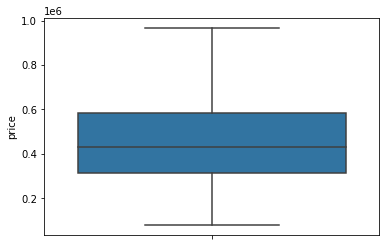

In [30]:
sns.boxplot(y='price', data=num)
plt.show()

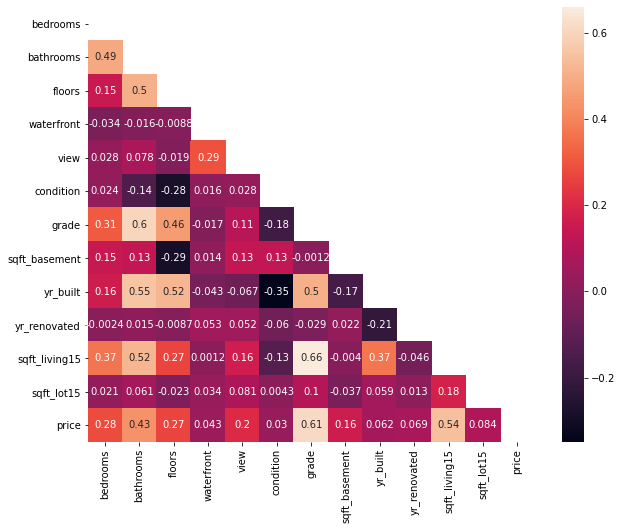

In [41]:
correlations_matrix= num.corr()
mask = np.zeros_like(correlations_matrix)
mask[np.triu_indices_from(mask)] = True
fig, ax = plt.subplots(figsize=(10, 8))
ax = sns.heatmap(correlations_matrix, mask=mask, annot=True)
plt.show()

data Price Mean: 462799.0174022066
data Price Median: 430000.0
data Price Max: 967500
data Price Skew: 0.5760679378111233


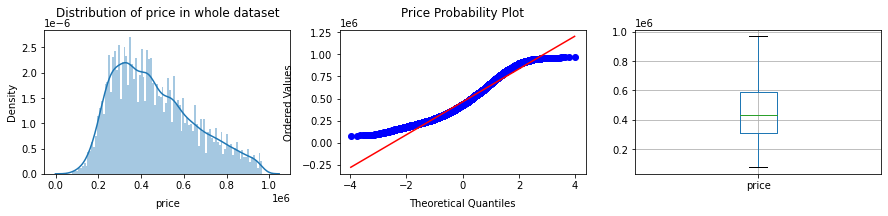

In [42]:
print('data Price Mean: {}'.format(data['price'].mean()))
print('data Price Median: {}'.format(data['price'].median()))
print('data Price Max: {}'.format(data['price'].max()))
print('data Price Skew: {}'.format(data['price'].skew()))

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize = (15,2))
plt.subplots_adjust(left=None, bottom=5, right=None, top=6, wspace=None, hspace=None)

sns.distplot(num['price'], hist=True, bins = 100, ax=ax1)
probplot(num['price'], plot=ax2)
data.boxplot('price', ax=ax3)

ax1.set_xlabel('price', size=10, labelpad=8)
ax2.set_xlabel('Theoretical Quantiles', size=10, labelpad=8)
ax2.set_ylabel('Ordered Values', size=10, labelpad=8)

ax1.set_title('Distribution of price in whole dataset', size=12, y=1.05)
ax2.set_title('Price Probability Plot', size=12, y=1.05)

plt.show()

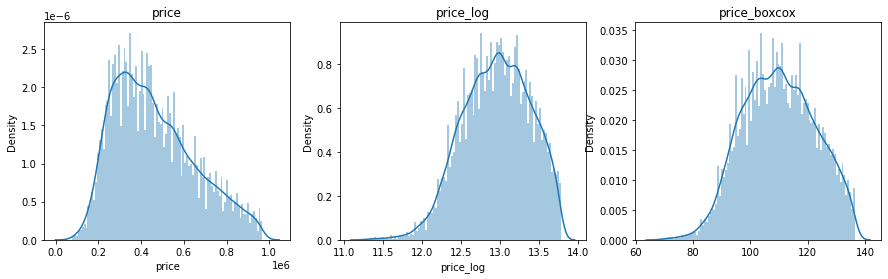

In [43]:
from scipy import stats
def feat_log_box(df, feature, bins):
    """makes a log Transformation and a boxcox transformation of a feature of a dataframe. \n
    0 values are replaced with the mean in the transformation: \n
    plots 3 distplots next to each other for comparison \n
    tales 3 arguments (df, feature, bins)"""
    df[feature+'_log'] = list(map(lambda x: np.log(x) if np.isfinite(x) else np.NAN, df[feature]))
    df[feature+'_log'] = df[feature+'_log'].fillna(np.mean(df[feature+'_log']))
    df[feature+'_boxcox'] = np.where(df[feature]<=0,0,df[feature])
    mean = np.sum(df[feature+'_boxcox'])/len(df[df[feature+'_boxcox']>0])
    df[feature+'_boxcox'] = df[feature+'_boxcox'].replace(0,mean)
    xt, lmbda = stats.boxcox(df[feature+'_boxcox'])
    df[feature+'_boxcox'] = xt
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize = (15,4))
    sns.distplot(df[feature], bins, ax=ax1)
    ax1.set_title(feature)
    sns.distplot(df[feature+'_log'], bins, ax=ax2)
    ax2.set_title(feature + '_log')
    sns.distplot(xt, bins, ax=ax3)
    ax3.set_title(feature + '_boxcox')
    
feat_log_box(data, 'price', 100)

In [44]:
# data=data.drop(['price','price_log'], axis=1)

In [45]:
num=data.select_dtypes(include='number')

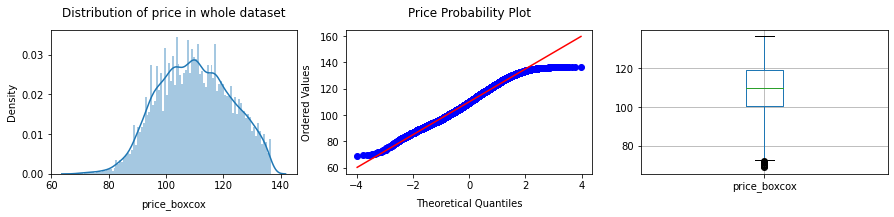

In [46]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize = (15,2))
plt.subplots_adjust(left=None, bottom=5, right=None, top=6, wspace=None, hspace=None)

sns.distplot(num['price_boxcox'], hist=True, bins = 100, ax=ax1)
probplot(num['price_boxcox'], plot=ax2)
data.boxplot('price_boxcox', ax=ax3)

ax1.set_xlabel('price_boxcox', size=10, labelpad=8)
ax2.set_xlabel('Theoretical Quantiles', size=10, labelpad=8)
ax2.set_ylabel('Ordered Values', size=10, labelpad=8)

ax1.set_title('Distribution of price in whole dataset', size=12, y=1.05)
ax2.set_title('Price Probability Plot', size=12, y=1.05)

plt.show()

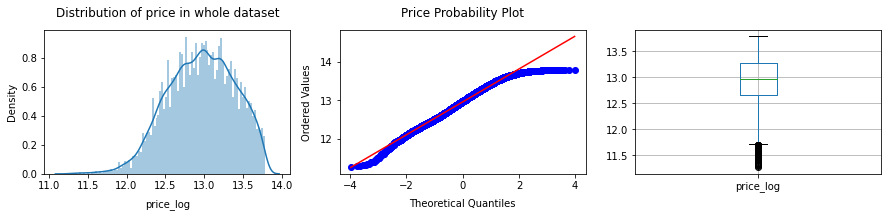

In [47]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize = (15,2))
plt.subplots_adjust(left=None, bottom=5, right=None, top=6, wspace=None, hspace=None)

sns.distplot(num['price_log'], hist=True, bins = 100, ax=ax1)
probplot(num['price_log'], plot=ax2)
data.boxplot('price_log', ax=ax3)

ax1.set_xlabel('price_log', size=10, labelpad=8)
ax2.set_xlabel('Theoretical Quantiles', size=10, labelpad=8)
ax2.set_ylabel('Ordered Values', size=10, labelpad=8)

ax1.set_title('Distribution of price in whole dataset', size=12, y=1.05)
ax2.set_title('Price Probability Plot', size=12, y=1.05)

plt.show()

In [48]:
# def outliers(column, threshold = 3): #define a funciton like this, so there is a predefault value
#     '''labels oultiers, dedect outliers according to mean and standartddeviation 
#     and a defined threshld which is the nuer of standarddeviations,taht are the outliers, outlier has to be removed still'''
#     return column[abs(column.apply(lambda x: (x-column.mean())/column.var() **(1/2))) >threshold]

In [49]:
Y = num['price_boxcox']
num = num.drop(['price_boxcox'], axis=1)

In [50]:
from sklearn.preprocessing import StandardScaler #normalizer is an alternative to Standardscaler. Norm distributes between 0 and 1, Sscaler distributes between -1 an +1
fitted = StandardScaler().fit(num)
x_scaled = fitted.transform(num)
print(x_scaled.shape)
x=pd.DataFrame(x_scaled)

(19940, 15)


In [51]:
X_train, X_test, y_train, y_test = train_test_split(x, Y, test_size=0.3, random_state=100)

NameError: name 'Y' is not defined

In [ ]:
from sklearn import linear_model

In [ ]:
lm = linear_model.LinearRegression()
model = lm.fit(X_train,y_train)
predictions  = lm.predict(X_test)
r2_score(y_test, predictions)